In [22]:
import numpy as np

In [23]:
ally_data = np.load('uncertain_robot2_trajectories.npy', allow_pickle=True)
adversarial_data = np.load('uncertain_robot3_trajectories.npy', allow_pickle=True)

In [24]:
print(ally_data)

[array([[ 1.06300958e+00,  1.07765174e+00,  8.89119688e-01,
          1.03721524e+00],
        [ 1.12551701e+00,  1.15570827e+00,  8.95569730e-01,
          6.45004230e-02],
        [ 1.18752274e+00,  1.23416392e+00,  9.01980513e-01,
          6.41078310e-02],
        [ 1.24902756e+00,  1.31301287e+00,  9.08349289e-01,
          6.36877585e-02],
        [ 1.31003250e+00,  1.39224921e+00,  9.14673346e-01,
          6.32405683e-02],
        [ 1.37053891e+00,  1.47186689e+00,  9.20950013e-01,
          6.27666690e-02],
        [ 1.43054839e+00,  1.55185977e+00,  9.27176664e-01,
          6.22665130e-02],
        [ 1.49006285e+00,  1.63222164e+00,  9.33350723e-01,
          6.17405944e-02],
        [ 1.54908447e+00,  1.71294616e+00,  9.39469668e-01,
          6.11894468e-02],
        [ 1.60761571e+00,  1.79402694e+00,  9.45531032e-01,
          6.06136402e-02],
        [ 1.66565931e+00,  1.87545754e+00,  9.51532410e-01,
          6.00137788e-02],
        [ 1.72321826e+00,  1.95723141e+00, 

/var/folders/q1/9cxvxqjx6zx2p7c201z52qy40000gn/T/ipykernel_3783/2587072048.py:38: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')


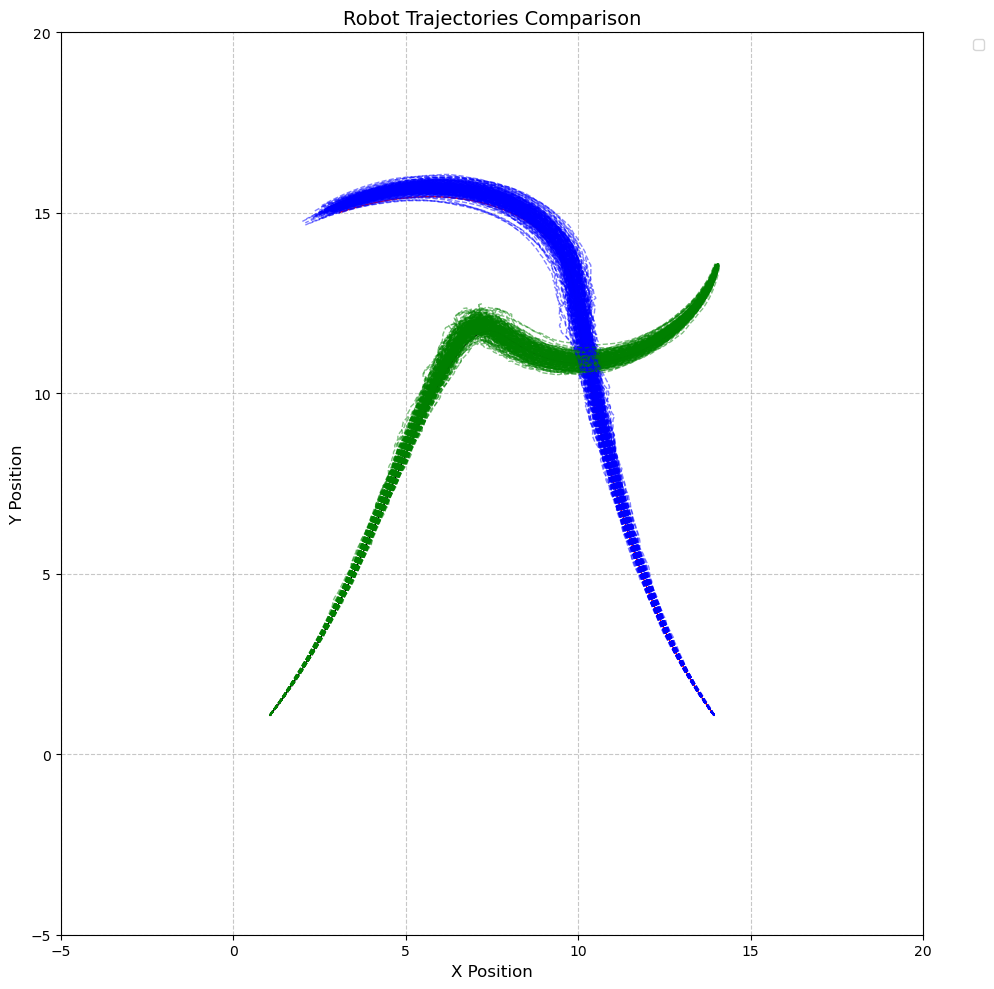

In [25]:
import matplotlib.pyplot as plt
import numpy as np

# Get trajectories indices 0-3
indices = range(200)
ally_trajectories = [ally_data[i][:] for i in indices]
adv_trajectories = [adversarial_data[i][:] for i in indices]

# Create figure
fig, ax = plt.subplots(figsize=(10,10))
ax.set_xlim([-5, 20])
ax.set_ylim([-5, 20])

# Colors and labels for different trajectories


# Plot all trajectories in a loop
for i in range(len(indices)):
    # Plot ally trajectory
    plt.plot(ally_trajectories[i][:,0], ally_trajectories[i][:,1], 
             f'k-' if i==0 else f'g--',
             alpha=1.0 if i==0 else 0.5,  # Ground truth solid, others transparent
             linewidth=1 if i==0 else 1)   # Ground truth thicker
            #  label= f'Ally Ground Truth' if i ==0 else f'Ally with uncertainty')
    
    # Plot adversary trajectory
    plt.plot(adv_trajectories[i][:,0], adv_trajectories[i][:,1], 
             f'r-' if i==0 else f'b--',  # Ground truth red solid, others dashed
             alpha=1.0 if i==0 else 0.5,
             linewidth=1 if i==0 else 1)
            #  label= f'Ally Ground Truth' if i ==0 else f'Ally with uncertainty')

# Customize plot
plt.grid(True, linestyle='--', alpha=0.7)
plt.xlabel('X Position', fontsize=12)
plt.ylabel('Y Position', fontsize=12)
plt.title('Robot Trajectories Comparison', fontsize=14)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

plt.show()

In [6]:
print(ally_trajectories)

[array([[ 1.06300958e+00,  1.07765174e+00,  8.89119688e-01,
         1.03721524e+00],
       [ 1.12551701e+00,  1.15570827e+00,  8.95569730e-01,
         6.45004230e-02],
       [ 1.18752274e+00,  1.23416392e+00,  9.01980513e-01,
         6.41078310e-02],
       [ 1.24902756e+00,  1.31301287e+00,  9.08349289e-01,
         6.36877585e-02],
       [ 1.31003250e+00,  1.39224921e+00,  9.14673346e-01,
         6.32405683e-02],
       [ 1.37053891e+00,  1.47186689e+00,  9.20950013e-01,
         6.27666690e-02],
       [ 1.43054839e+00,  1.55185977e+00,  9.27176664e-01,
         6.22665130e-02],
       [ 1.49006285e+00,  1.63222164e+00,  9.33350723e-01,
         6.17405944e-02],
       [ 1.54908447e+00,  1.71294616e+00,  9.39469668e-01,
         6.11894468e-02],
       [ 1.60761571e+00,  1.79402694e+00,  9.45531032e-01,
         6.06136402e-02],
       [ 1.66565931e+00,  1.87545754e+00,  9.51532410e-01,
         6.00137788e-02],
       [ 1.72321826e+00,  1.95723141e+00,  9.57471460e-01,
     

In [19]:
max_length = max(len(lst) for lst in ally_trajectories)
print(max_length)

for i in range(max_length):

        values = [lst[i][0] for lst in ally_trajectories if i < len(lst)]

print(values)

225
[13.963072779733018]


In [25]:
print(len(ally_trajectories))

1001


In [8]:
def calculate_element_means(lists, element):

    max_length = max(len(lst) for lst in lists)
    
    means = []

    for i in range(max_length):

        values = [lst[i][element] for lst in lists if i < len(lst)]

        if values:
            avg = sum(values) / len(values)
            means.append(avg)

    return means


In [9]:
mean_ally_x = calculate_element_means(lists = ally_trajectories, element = 0)
mean_ally_y = calculate_element_means(lists = ally_trajectories, element = 1)

mean_adv_x = calculate_element_means(lists = adv_trajectories, element = 0)
mean_adv_y = calculate_element_means(lists = adv_trajectories, element = 1)

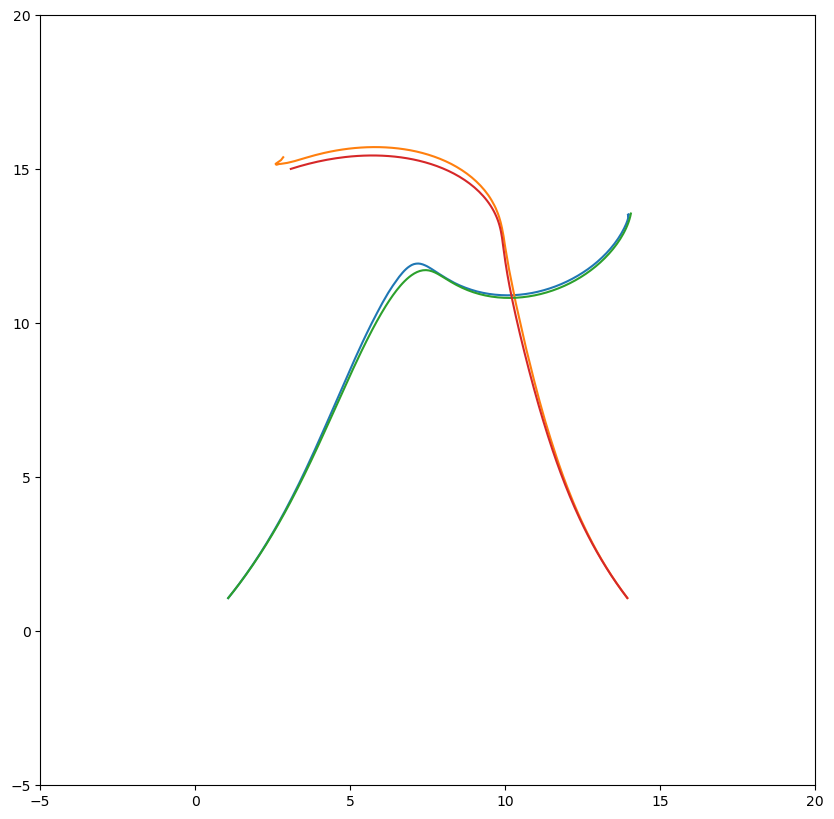

In [10]:
fig, ax = plt.subplots(figsize = (10,10))
ax.set_xlim([-5, 20])
ax.set_ylim([-5, 20])

plt.plot(mean_ally_x, mean_ally_y)
plt.plot(mean_adv_x, mean_adv_y)
plt.plot(ally_trajectories[0][:,0], ally_trajectories[0][:,1])
plt.plot(adv_trajectories[0][:,0], adv_trajectories[0][:,1])

In [11]:
def calculate_variance_distribution(lists, element):

    max_length = max(len(lst) for lst in lists)
    arr = np.ma.empty((len(lists), max_length))
    arr.mask = True

    for i, lst in enumerate(lists):
        for j in range(len(lst)):
            arr[i, j] = lst[j][element]
            arr.mask[i,j] = False
    means = arr.mean(axis = 0).data
    variances = arr.var(axis = 0).data
    
    position_values = []
    
    return arr

In [12]:
def gaussian(x, mu, sigma, amplitude):
    """
    Gaussian function with parameters:
    mu: mean
    sigma: standard deviation
    amplitude: scaling factor
    """
    return amplitude * np.exp(-0.5 * ((x - mu) / sigma) ** 2)

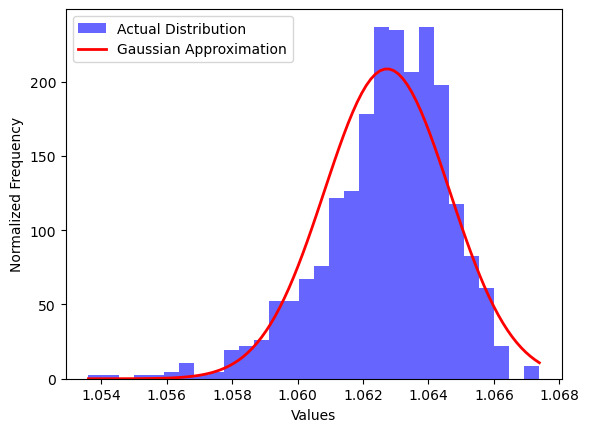

In [14]:
values = calculate_variance_distribution(ally_trajectories, 0)[:,0]

from scipy.optimize import curve_fit
from scipy import stats


mean_values = np.mean(values, axis = 0)
vars_values = np.var(values, axis = 0)

std_values = np.std(values, axis=0)

# Calculate a reasonable number of bins using Sturges' rule
n_bins = int(3.3 * np.log2(len(values)) + 1)  # or any other number you prefer

plt.hist(values, bins='auto', density=True, alpha=0.6, color='blue', 
             label='Actual Distribution')

x = np.linspace(min(values), max(values), 100)
gaussian = stats.norm.pdf(x, mean_values, std_values)

plt.plot(x, gaussian, 'r-', lw=2, label = 'Gaussian Approximation')

plt.xlabel('Values')
plt.ylabel('Normalized Frequency')
plt.legend()
plt.show()


In [16]:
vars_values

3.652625562337238e-06